# 구글드라이브 마운트

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# 폴더 이동

In [2]:
cd /content/drive/MyDrive/UNet 구현

/content/drive/MyDrive/UNet 구현


In [3]:
pwd

'/content/drive/MyDrive/UNet 구현'

# Import

In [4]:
import os
import numpy as np
import glob
import time

import torch
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter


import albumentations as A
from albumentations.pytorch import transforms

import copy
from torchvision.utils import save_image

from PIL import Image
import matplotlib.pyplot as plt


# ISBI 2012 dataset 만들기

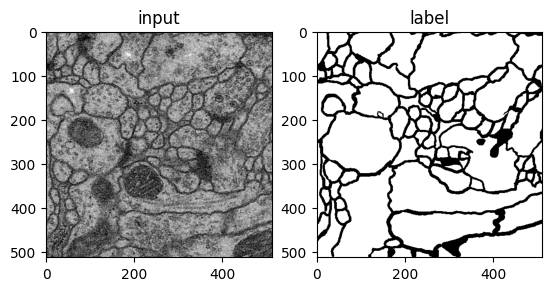

In [6]:
## 데이터 불러오기
dir_data = './data'

name_label = 'train-labels.tif'
name_input = 'train-volume.tif'

img_label = Image.open(os.path.join(dir_data, name_label))
img_input = Image.open(os.path.join(dir_data, name_input))

ny, nx = img_label.size
nframe = img_label.n_frames

## train/test/val 폴더 생성
nframe_train = 24
nframe_val = 3
nframe_test = 3

dir_save_train = os.path.join(dir_data, 'train')
dir_save_val = os.path.join(dir_data, 'val')
dir_save_test = os.path.join(dir_data, 'test')

if not os.path.exists(dir_save_train):
    os.makedirs(dir_save_train)

if not os.path.exists(dir_save_val):
    os.makedirs(dir_save_val)

if not os.path.exists(dir_save_test):
    os.makedirs(dir_save_test)

## 전체 이미지 30개를 섞어줌
id_frame = np.arange(nframe)
np.random.shuffle(id_frame)

## 선택된 train 이미지를 npy 파일로 저장
offset_nframe = 0

for i in range(nframe_train):
    img_label.seek(id_frame[i + offset_nframe])
    img_input.seek(id_frame[i + offset_nframe])

    label_ = np.asarray(img_label)
    input_ = np.asarray(img_input)

    np.save(os.path.join(dir_save_train, 'label_%03d.npy' % i), label_)
    np.save(os.path.join(dir_save_train, 'input_%03d.npy' % i), input_)

## 선택된 val 이미지를 npy 파일로 저장
offset_nframe = nframe_train

for i in range(nframe_val):
    img_label.seek(id_frame[i + offset_nframe])
    img_input.seek(id_frame[i + offset_nframe])

    label_ = np.asarray(img_label)
    input_ = np.asarray(img_input)

    np.save(os.path.join(dir_save_val, 'label_%03d.npy' % i), label_)
    np.save(os.path.join(dir_save_val, 'input_%03d.npy' % i), input_)

## 선택된 test 이미지를 npy 파일로 저장
offset_nframe = nframe_train + nframe_val

for i in range(nframe_test):
    img_label.seek(id_frame[i + offset_nframe])
    img_input.seek(id_frame[i + offset_nframe])

    label_ = np.asarray(img_label)
    input_ = np.asarray(img_input)

    np.save(os.path.join(dir_save_test, 'label_%03d.npy' % i), label_)
    np.save(os.path.join(dir_save_test, 'input_%03d.npy' % i), input_)

## 이미지 시각화
plt.subplot(122)
plt.imshow(label_, cmap='gray')
plt.title('label')

plt.subplot(121)
plt.imshow(input_, cmap='gray')
plt.title('input')

plt.show()

# Custom dataset

In [5]:
class Dataset(torch.utils.data.Dataset):
    def __init__(self, data_dir, transform=None):
        self.data_dir = data_dir
        self.transform = transform

        f_data = os.listdir(self.data_dir)
        f_label = [f for f in f_data if f.startswith('label')]
        f_input = [f for f in f_data if f.startswith('input')]

        f_label.sort()
        f_input.sort()

        self.f_label = f_label
        self.f_input = f_input

    def __len__(self):
        return len(self.f_label)

    def __getitem__(self, index):
        label = np.load(os.path.join(self.data_dir, self.f_label[index]))
        input = np.load(os.path.join(self.data_dir, self.f_input[index]))

        if label.ndim == 2:
            label = label[:, :, np.newaxis]
        if input.ndim == 2:
            input = input[:, :, np.newaxis]


        if self.transform:
            data = self.transform(image=input, mask=label)
            data_img = data["image"]
            data_label = data["mask"]

            data = {'input': data_img, 'label': data_label}
        else:
            data = {'input': input, 'label': label}

        return data

# Custom Dataset 구현 확인

In [6]:
pwd

'/content/drive/MyDrive/UNet 구현'

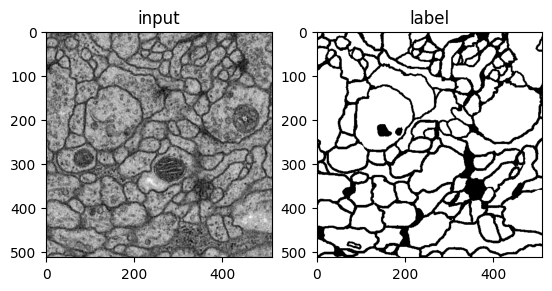

In [7]:
dataset_train = Dataset(data_dir='./data/train')
data = dataset_train.__getitem__(0)
input = data['input']
label = data['label']

# 불러온 이미지 시각화
plt.subplot(122)
plt.imshow(label.reshape(512,512), cmap='gray')
plt.title('label')

plt.subplot(121)
plt.imshow(input.reshape(512,512), cmap='gray')
plt.title('input')

plt.show()

# U-Net 구현

In [8]:
def double_conv_layer(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=True):
    return nn.Sequential(
        nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(num_features=out_channels),
        nn.ReLU(),
        nn.Conv2d(in_channels=out_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(num_features=out_channels),
        nn.ReLU()
    )

def conv_layer(in_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=True):
    return nn.Sequential(
        nn.Conv2d(in_channels=in_channels, out_channels=out_channels, kernel_size=kernel_size, stride=stride, padding=padding, bias=bias),
        nn.BatchNorm2d(num_features=out_channels),
        nn.ReLU()
    )

class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()

        self.maxpool = nn.MaxPool2d(kernel_size=2)

        self.contract_1 = double_conv_layer(in_channels=1, out_channels=64)
        self.contract_2 = double_conv_layer(in_channels=64, out_channels=128)
        self.contract_3 = double_conv_layer(in_channels=128, out_channels=256)
        self.contract_4 = double_conv_layer(in_channels=256, out_channels=512)
        self.contract_5 = double_conv_layer(in_channels=512, out_channels=1024)

        self.expansive_5 = conv_layer(in_channels=1024, out_channels=512)
        self.unpool_4 = nn.ConvTranspose2d(in_channels=512, out_channels=512, kernel_size=2, stride=2, padding=0, bias=True)
        self.expansive_4_1 = conv_layer(in_channels=2*512, out_channels=512)
        self.expansive_4_2 = conv_layer(in_channels=512, out_channels=256)
        self.unpool_3 = nn.ConvTranspose2d(in_channels=256, out_channels=256, kernel_size=2, stride=2, padding=0, bias=True)
        self.expansive_3_1 = conv_layer(in_channels=2*256, out_channels=256)
        self.expansive_3_2 = conv_layer(in_channels=256, out_channels=128)
        self.unpool_2 = nn.ConvTranspose2d(in_channels=128, out_channels=128, kernel_size=2, stride=2, padding=0, bias=True)
        self.expansive_2_1 = conv_layer(in_channels=2*128, out_channels=128)
        self.expansive_2_2 = conv_layer(in_channels=128, out_channels=64)
        self.unpool_1 = nn.ConvTranspose2d(in_channels=64, out_channels=64, kernel_size=2, stride=2, padding=0, bias=True)
        self.expansive_1_1 = conv_layer(in_channels=2*64, out_channels=64)
        self.expansive_1_2 = conv_layer(in_channels=64, out_channels=64)
        self.fc = nn.Conv2d(in_channels=64, out_channels=1, kernel_size=1, stride=1, padding=0, bias=True)

    def forward(self, x):
        conv1 = self.contract_1(x)
        pool1 = self.maxpool(conv1)

        conv2 = self.contract_2(pool1)
        pool2 = self.maxpool(conv2)

        conv3 = self.contract_3(pool2)
        pool3 = self.maxpool(conv3)

        conv4 = self.contract_4(pool3)
        pool4 = self.maxpool(conv4)

        conv5 = self.contract_5(pool4)

        dconv5 = self.expansive_5(conv5)

        unpool4 = self.unpool_4(dconv5)
        cat4 = torch.cat([unpool4, conv4], dim=1)
        dconv4_1 = self.expansive_4_1(cat4)
        dconv4_2 = self.expansive_4_2(dconv4_1)

        unpool3 = self.unpool_3(dconv4_2)
        cat3 = torch.cat([unpool3, conv3], dim=1)
        dconv3_1 = self.expansive_3_1(cat3)
        dconv3_2 = self.expansive_3_2(dconv3_1)

        unpool2 = self.unpool_2(dconv3_2)
        cat2 = torch.cat([unpool2, conv2], dim=1)
        dconv2_1 = self.expansive_2_1(cat2)
        dconv2_2 = self.expansive_2_2(dconv2_1)

        unpool1 = self.unpool_1(dconv2_2)
        cat1 = torch.cat([unpool1, conv1], dim=1)
        dconv1_1 = self.expansive_1_1(cat1)
        dconv1_2 = self.expansive_1_2(dconv1_1)

        x = self.fc(dconv1_2)

        return x

# Hyperparameter

In [9]:
pwd

'/content/drive/MyDrive/UNet 구현'

In [10]:
data_dir = "./data"
ckpt_dir = "./checkpoint"
log_dir = "./log"


batch_size = 1
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
lr = 1e-3
num_epoch = 50
st_epoch = 0

fn_tonumpy = lambda x: x.to('cpu').detach().numpy().transpose(0, 2, 3, 1)
fn_denorm = lambda x, mean, std: (x * std) + mean
fn_class = lambda x: 1.0 * (x > 0.5)

writer_train =  SummaryWriter(log_dir=os.path.join(log_dir, 'train'))
writer_val = SummaryWriter(log_dir=os.path.join(log_dir, 'val'))

# 네트워크 저장

In [11]:
## 네트워크 저장하기
def save(ckpt_dir, net, optim, epoch):
    if not os.path.exists(ckpt_dir):
        os.makedirs(ckpt_dir)

    torch.save({'net': net.state_dict(), 'optim': optim.state_dict()},
               "%s/model_epoch%d.pth" % (ckpt_dir, epoch))

## 네트워크 불러오기
def load(ckpt_dir, net, optim):
    if not os.path.exists(ckpt_dir):
        epoch = 0
        return net, optim, epoch

    ckpt_lst = os.listdir(ckpt_dir)
    ckpt_lst.sort(key=lambda f: int(''.join(filter(str.isdigit, f))))

    dict_model = torch.load('%s/%s' % (ckpt_dir, ckpt_lst[-1]))

    net.load_state_dict(dict_model['net'])
    optim.load_state_dict(dict_model['optim'])
    epoch = int(ckpt_lst[-1].split('epoch')[1].split('.pth')[0])

    return net, optim, epoch

# Dataloader

In [12]:
transform_train = A.Compose([
    A.HorizontalFlip(),
    A.VerticalFlip(),
    A.Normalize(mean=0.5, std=0.5),
    transforms.ToTensorV2(transpose_mask=True)
])
transform_val = A.Compose([
    A.HorizontalFlip(),
    A.Normalize(mean=0.5, std=0.5),
    transforms.ToTensorV2(transpose_mask=True)
])

dataset_train = Dataset(data_dir=os.path.join(data_dir, 'train'), transform=transform_train)
train_dataloader = DataLoader(dataset_train, batch_size=batch_size, shuffle=False, num_workers=4)

dataset_val = Dataset(data_dir=os.path.join(data_dir, 'val'), transform=transform_val)
val_dataloader = DataLoader(dataset_val, batch_size=batch_size, shuffle=False, num_workers=4)

num_data_train = len(dataset_train)
num_data_val = len(dataset_val)

num_batch_train = np.ceil(num_data_train / batch_size)
num_batch_val = np.ceil(num_data_val / batch_size)

# Model 생성, loss, optimizer

In [13]:
# model, optim, st_epoch = load(ckpt_dir=ckpt_dir, net=net, optim=optim)
model = UNet().to(device)

# 손실함수 정의하기
fn_loss = nn.BCEWithLogitsLoss().to(device)

# Optimizer 설정하기
optim = torch.optim.Adam(model.parameters(), lr=lr)

# Train

In [14]:
since = time.time()
best_model_wts = copy.deepcopy(model.state_dict())
best_loss = 100

for epoch in range(st_epoch + 1, num_epoch + 1):
        model.train()
        loss_arr = []

        for batch, data in enumerate(train_dataloader, 1):
            # forward pass
            data['label'] = data['label']/255.0

            label = data['label'].to(device)
            input = data['input'].to(device)

            output = model(input)

            # backward pass
            optim.zero_grad()

            loss = fn_loss(output, label)
            loss.backward()

            optim.step()

            # 손실함수 계산
            loss_arr += [loss.item()]

            print("TRAIN: EPOCH %04d / %04d | BATCH %04d / %04d | LOSS %.4f" %
                  (epoch, num_epoch, batch, num_batch_train, np.mean(loss_arr)))

            # Tensorboard 저장하기
            label = fn_tonumpy(label)
            input = fn_tonumpy(fn_denorm(input, mean=0.5, std=0.5))
            output = fn_tonumpy(fn_class(output))

            writer_train.add_image('label', label, num_batch_train * (epoch - 1) + batch, dataformats='NHWC')
            writer_train.add_image('input', input, num_batch_train * (epoch - 1) + batch, dataformats='NHWC')
            writer_train.add_image('output', output, num_batch_train * (epoch - 1) + batch, dataformats='NHWC')

        writer_train.add_scalar('loss', np.mean(loss_arr), epoch)

        with torch.no_grad():
            model.eval()
            loss_arr = []

            for batch, data in enumerate(val_dataloader, 1):
                data['label'] = data['label'] / 255.0

                # forward pass
                label = data['label'].to(device)
                input = data['input'].to(device)

                output = model(input)

                # 손실함수 계산하기
                loss = fn_loss(output, label.float())

                loss_arr += [loss.item()]

                print("VALID: EPOCH %04d / %04d | BATCH %04d / %04d | LOSS %.4f" %
                      (epoch, num_epoch, batch, num_batch_val, np.mean(loss_arr)))

                # Tensorboard 저장하기
                label = fn_tonumpy(label)
                input = fn_tonumpy(fn_denorm(input, mean=0.5, std=0.5))
                output = fn_tonumpy(fn_class(output))

                writer_val.add_image('label', label, num_batch_val * (epoch - 1) + batch, dataformats='NHWC')
                writer_val.add_image('input', input, num_batch_val * (epoch - 1) + batch, dataformats='NHWC')
                writer_val.add_image('output', output, num_batch_val * (epoch - 1) + batch, dataformats='NHWC')

        writer_val.add_scalar('loss', np.mean(loss_arr), epoch)

        # epoch 50마다 모델 저장하기
        if epoch % 50 == 0:
            save(ckpt_dir=ckpt_dir, net=model, optim=optim, epoch=epoch)

        writer_train.close()
        writer_val.close()

TRAIN: EPOCH 0001 / 0050 | BATCH 0001 / 0024 | LOSS 0.6381
TRAIN: EPOCH 0001 / 0050 | BATCH 0002 / 0024 | LOSS 0.5543
TRAIN: EPOCH 0001 / 0050 | BATCH 0003 / 0024 | LOSS 0.5254
TRAIN: EPOCH 0001 / 0050 | BATCH 0004 / 0024 | LOSS 0.5064
TRAIN: EPOCH 0001 / 0050 | BATCH 0005 / 0024 | LOSS 0.4845
TRAIN: EPOCH 0001 / 0050 | BATCH 0006 / 0024 | LOSS 0.4663
TRAIN: EPOCH 0001 / 0050 | BATCH 0007 / 0024 | LOSS 0.4500
TRAIN: EPOCH 0001 / 0050 | BATCH 0008 / 0024 | LOSS 0.4377
TRAIN: EPOCH 0001 / 0050 | BATCH 0009 / 0024 | LOSS 0.4298
TRAIN: EPOCH 0001 / 0050 | BATCH 0010 / 0024 | LOSS 0.4189
TRAIN: EPOCH 0001 / 0050 | BATCH 0011 / 0024 | LOSS 0.4094
TRAIN: EPOCH 0001 / 0050 | BATCH 0012 / 0024 | LOSS 0.4005
TRAIN: EPOCH 0001 / 0050 | BATCH 0013 / 0024 | LOSS 0.3929
TRAIN: EPOCH 0001 / 0050 | BATCH 0014 / 0024 | LOSS 0.3864
TRAIN: EPOCH 0001 / 0050 | BATCH 0015 / 0024 | LOSS 0.3801
TRAIN: EPOCH 0001 / 0050 | BATCH 0016 / 0024 | LOSS 0.3786
TRAIN: EPOCH 0001 / 0050 | BATCH 0017 / 0024 | LOSS 0.37

In [15]:
%load_ext tensorboard

In [24]:
%reload_ext tensorboard

In [18]:
pwd

'/content/drive/MyDrive/UNet 구현'

In [16]:
%tensorboard --logdir './log/train'

<IPython.core.display.Javascript object>

In [18]:
%tensorboard --logdir './log/val' --port 6007

<IPython.core.display.Javascript object>

# Test

In [20]:
transform_test = A.Compose([
    A.Normalize(mean=0.5, std=0.5),
    transforms.ToTensorV2(transpose_mask=True)
])
dataset_test = Dataset(data_dir=os.path.join(data_dir, 'test'), transform=transform_test)
test_dataloader = DataLoader(dataset_test, batch_size=batch_size, shuffle=False, num_workers=4)

num_data_test = len(dataset_test)
num_batch_test = np.ceil(num_data_test / batch_size)

result_dir = './result'
if not os.path.exists(result_dir):
    os.makedirs(os.path.join(result_dir, 'png'))
    os.makedirs(os.path.join(result_dir, 'numpy'))

model, optim, st_epoch = load(ckpt_dir=ckpt_dir, net=model, optim=optim)

with torch.no_grad():
      model.eval()
      loss_arr = []

      for batch, data in enumerate(test_dataloader, 1):
          data['label'] = data['label'] / 255.0

          # forward pass
          label = data['label'].to(device)
          input = data['input'].to(device)

          output = model(input)

          # 손실함수 계산하기
          loss = fn_loss(output, label)

          loss_arr += [loss.item()]

          print("TEST: BATCH %04d / %04d | LOSS %.4f" %
                (batch, num_batch_test, np.mean(loss_arr)))

          # Tensorboard 저장하기
          label = fn_tonumpy(label)
          input = fn_tonumpy(fn_denorm(input, mean=0.5, std=0.5))
          output = fn_tonumpy(fn_class(output))

          # 테스트 결과 저장하기
          for j in range(label.shape[0]):
              id = num_batch_test * (batch - 1) + j

              plt.imsave(os.path.join(result_dir, 'png', 'label_%04d.png' % id), label[j].squeeze(), cmap='gray')
              plt.imsave(os.path.join(result_dir, 'png', 'input_%04d.png' % id), input[j].squeeze(), cmap='gray')
              plt.imsave(os.path.join(result_dir, 'png', 'output_%04d.png' % id), output[j].squeeze(), cmap='gray')

              np.save(os.path.join(result_dir, 'numpy', 'label_%04d.npy' % id), label[j].squeeze())
              np.save(os.path.join(result_dir, 'numpy', 'input_%04d.npy' % id), input[j].squeeze())
              np.save(os.path.join(result_dir, 'numpy', 'output_%04d.npy' % id), output[j].squeeze())

print("AVERAGE TEST: BATCH %04d / %04d | LOSS %.4f" %
        (batch, num_batch_test, np.mean(loss_arr)))

TEST: BATCH 0001 / 0003 | LOSS 0.2050
TEST: BATCH 0002 / 0003 | LOSS 0.2534
TEST: BATCH 0003 / 0003 | LOSS 0.2340
AVERAGE TEST: BATCH 0003 / 0003 | LOSS 0.2340


#test 시각화(input, label, prediction)

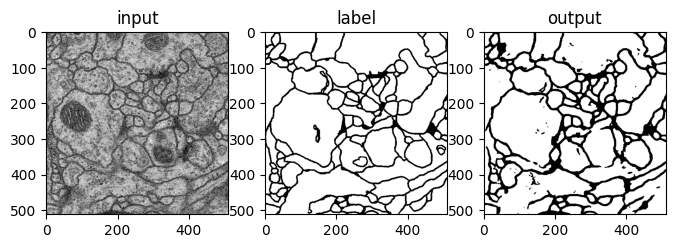

In [21]:
lst_data = os.listdir(os.path.join(result_dir, 'numpy'))

lst_label = [f for f in lst_data if f.startswith('label')]
lst_input = [f for f in lst_data if f.startswith('input')]
lst_output = [f for f in lst_data if f.startswith('output')]

lst_label.sort()
lst_input.sort()
lst_output.sort()

##
id = 0

label = np.load(os.path.join(result_dir,"numpy", lst_label[id]))
input = np.load(os.path.join(result_dir,"numpy", lst_input[id]))
output = np.load(os.path.join(result_dir,"numpy", lst_output[id]))

## 플롯 그리기
plt.figure(figsize=(8,6))
plt.subplot(131)
plt.imshow(input, cmap='gray')
plt.title('input')

plt.subplot(132)
plt.imshow(label, cmap='gray')
plt.title('label')

plt.subplot(133)
plt.imshow(output, cmap='gray')
plt.title('output')

plt.show()
